# Project 2 - Dimensionality Reduction

In this project, you will work with a custom handwritten character dataset. You will implement dimensionality reduction and manifold learning techniques for visualization and subsequent classification tasks to report on a set of questions.

The goal of this assignment include:

1. Dataset visualization and interpretability via dimensionality reduction
2. Implement dimensionality reduction techniques with ```scikit-learn```
3. Carry out experiments to select best subspace projections
4. Design pipelines for hyperparameter tuning and model selection
5. Implement performance evaluation metrics and evaluate results
6. Report observations, propose business-centric solutions and propose mitigating strategies

## Deliverables

As part of this project, you should deliver the following materials:

1. [**4-page IEEE-format paper**](https://www.ieee.org/conferences/publishing/templates.html). Write a paper with no more than 4 pages addressing the questions posed below. When writing this report, consider a business-oriented person as your reader (e.g. your PhD advisor, your internship manager, etc.). Tell *the story* for each datasets' goal and propose solutions by addressing (at least) the questions posed below.

2. **Python Code**. Create two separate Notebooks: (1) "training.ipynb" used for training and hyperparameter tuning, (2) "test.ipynb" for evaluating the final trained model in the test set. The "test.ipynb" should load all trained objects and simply evaluate the performance. So don't forget to **push the trained models** to your repository to allow us to run it.

All of your code should run without any errors and be well-documented.

3. **README.md file**. Edit the readme.md file in your repository and how to use your code. If there are user-defined parameters, your readme.md file must clearly indicate so and demonstrate how to use your code. **Consider the case where the user wants to utilize your code to run on a different test set. Indicate in your readme.md file how this can be achieved.**

This is an **individual assignment**.

These deliverables are **due Monday, November 14 @ 11:59pm**. Late submissions will not be accepted, so please plan accordingly.

---

# About the Dataset

The training dataset is saved as a ```numpy``` array and contains a total of 6720 images from 10 classes. Each image is in grayscale and of size $300\times 300$. The 10 classes and its label encoding are:

| Character | a | b | c | d | e | f | g | h | $ | # |
| ----      | --| --| --| --| --| --| --| --| --| --|
| Label     |  0| 1 | 2 | 3 | 4 | 5 | 6 | 7 | 8 | 9 |

In [1]:
class_names = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', '$', '#']

Let's visualize the dataset:

In [2]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

# Loading Training Data
X_train = np.load('data_train.npy').T
t_train = np.load('labels_train.npy')

print(X_train.shape, t_train.shape)

(6720, 90000) (6720,)


In [3]:
from PIL import Image
import cv2

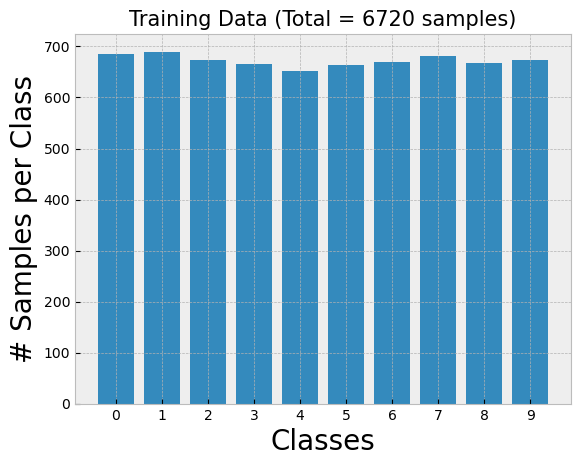

In [4]:
# Counting number samples per class
vals, counts = np.unique(t_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train.shape[0])+' samples)',size=15);

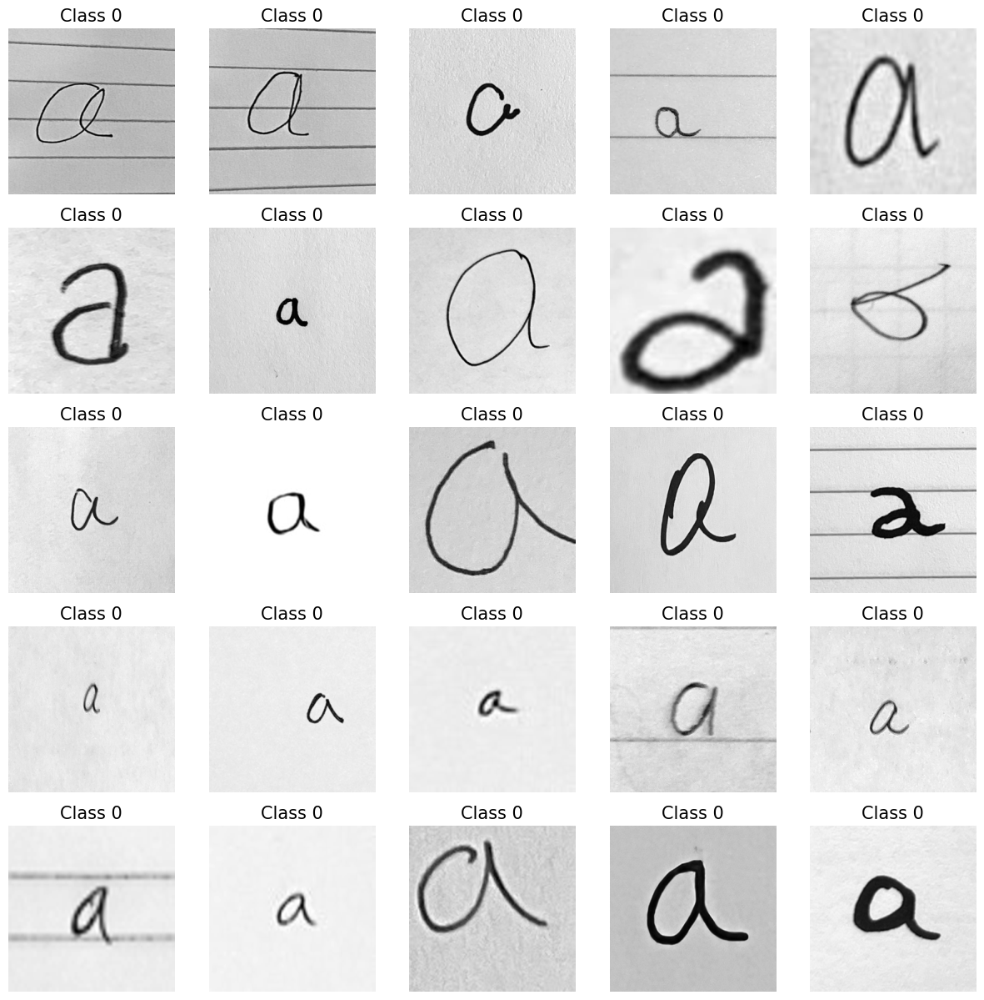

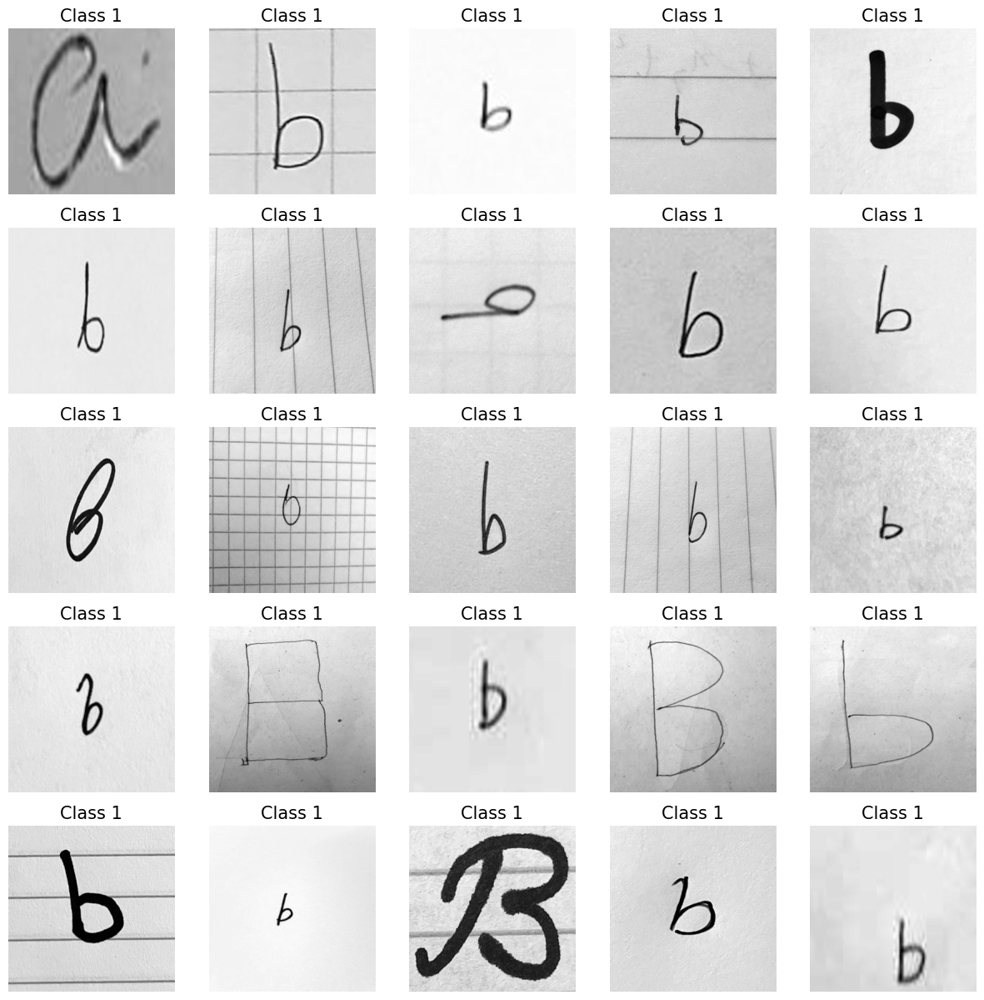

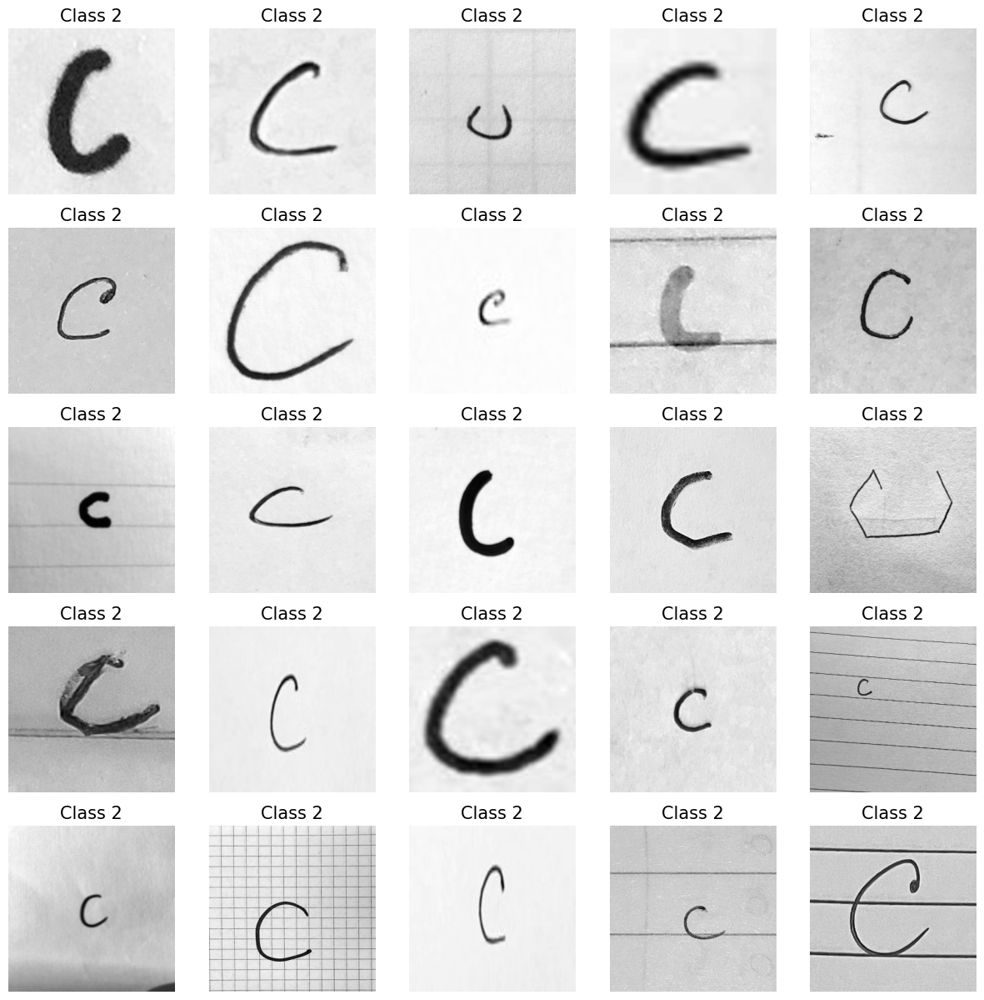

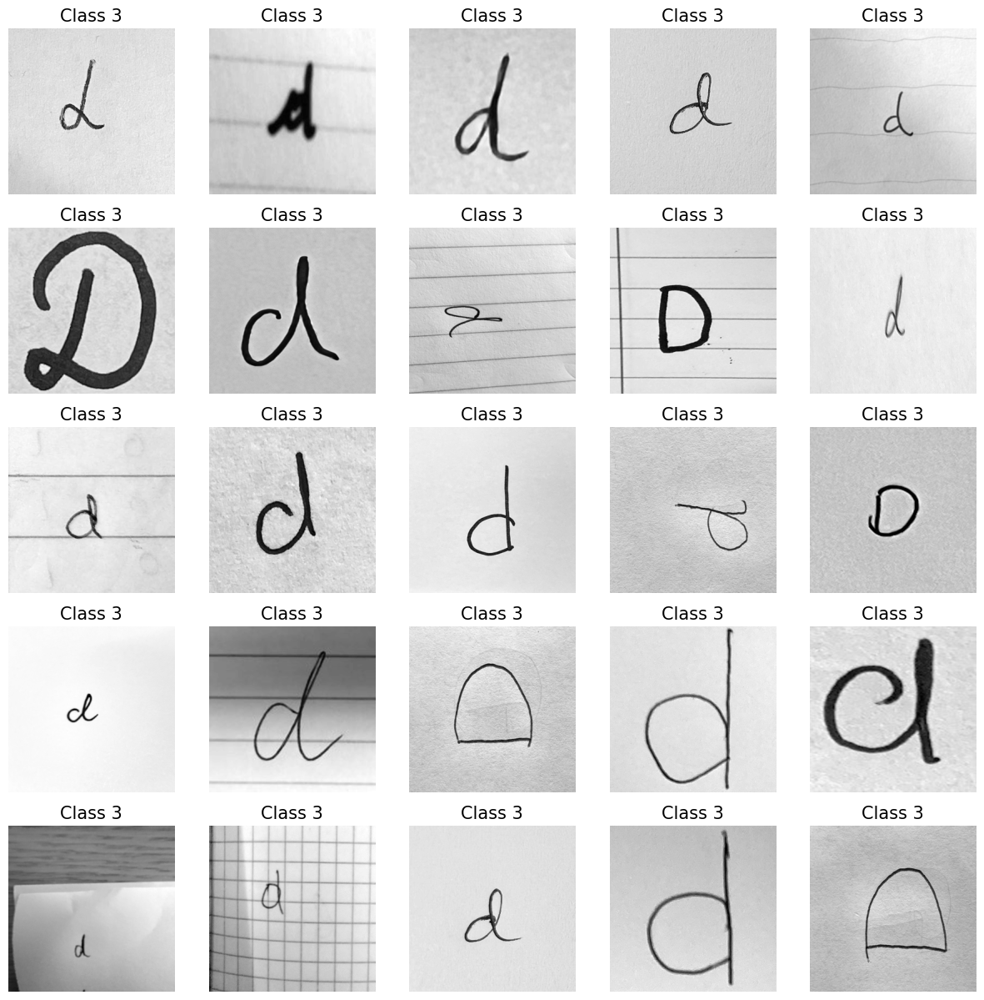

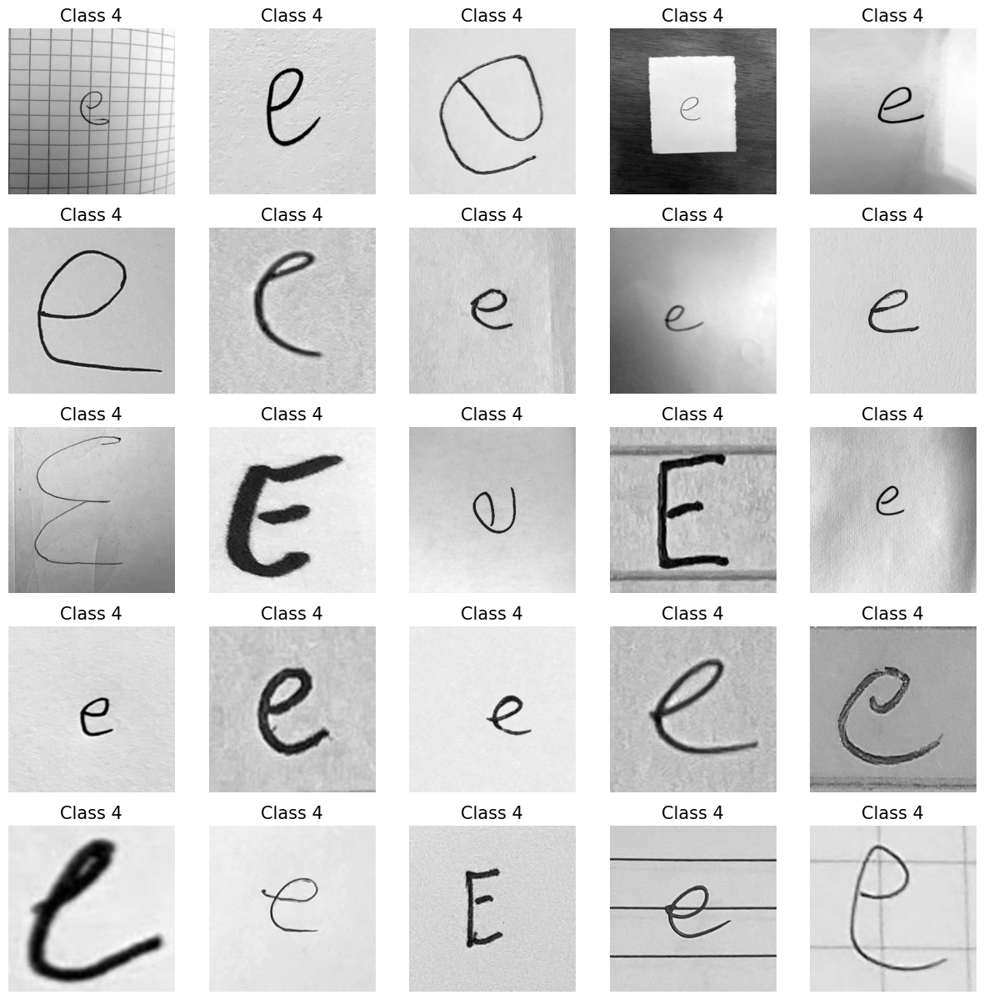

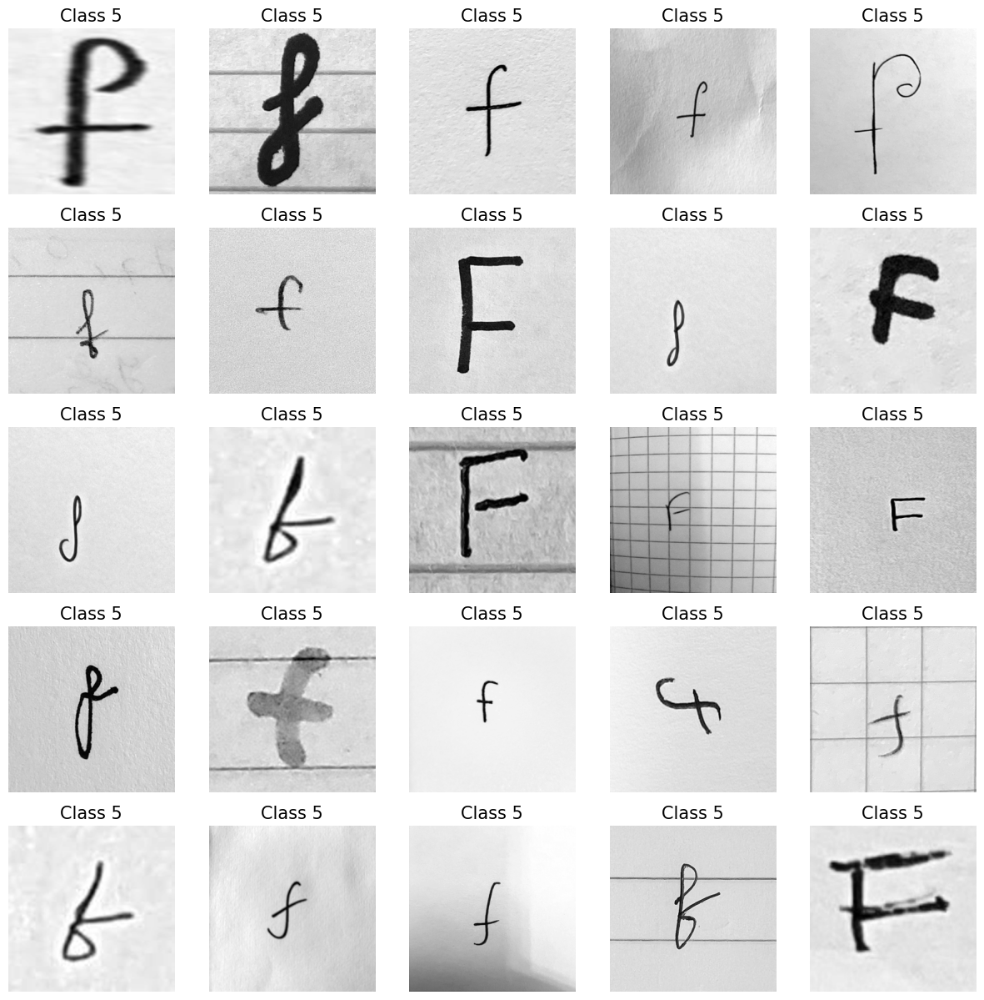

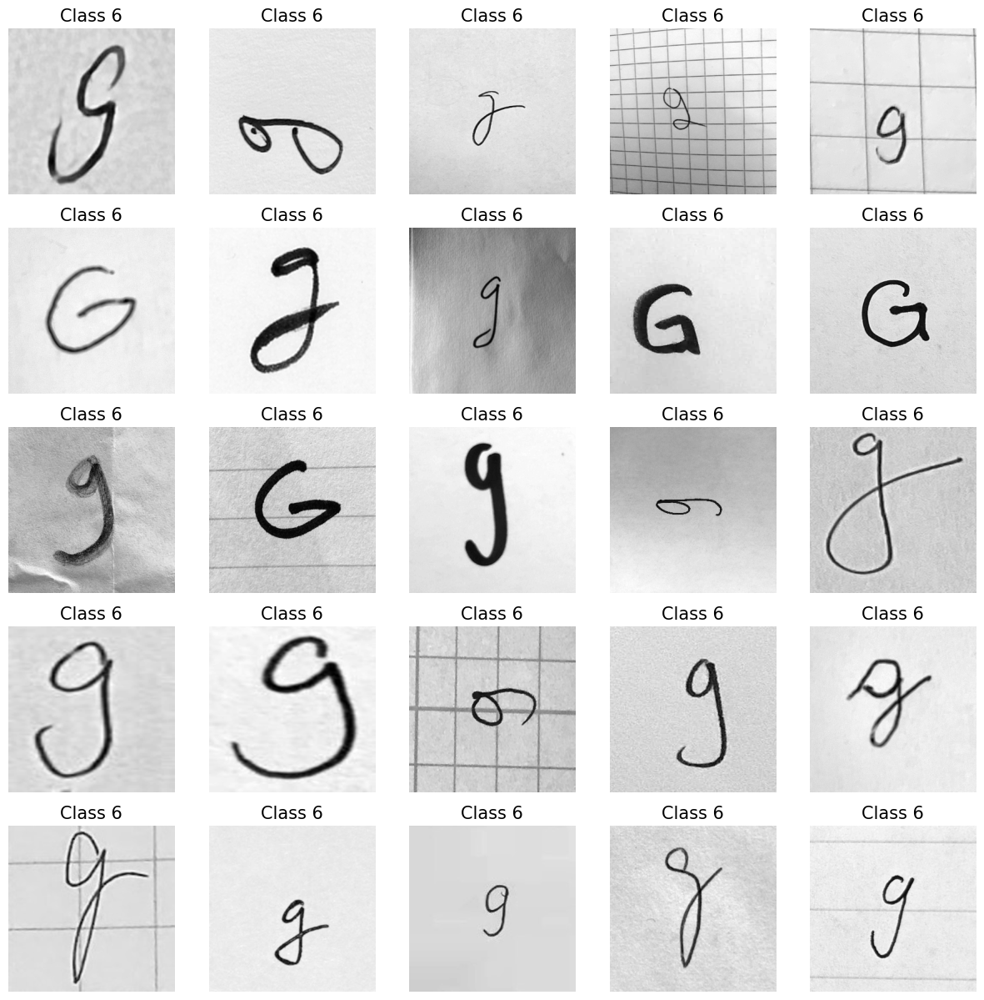

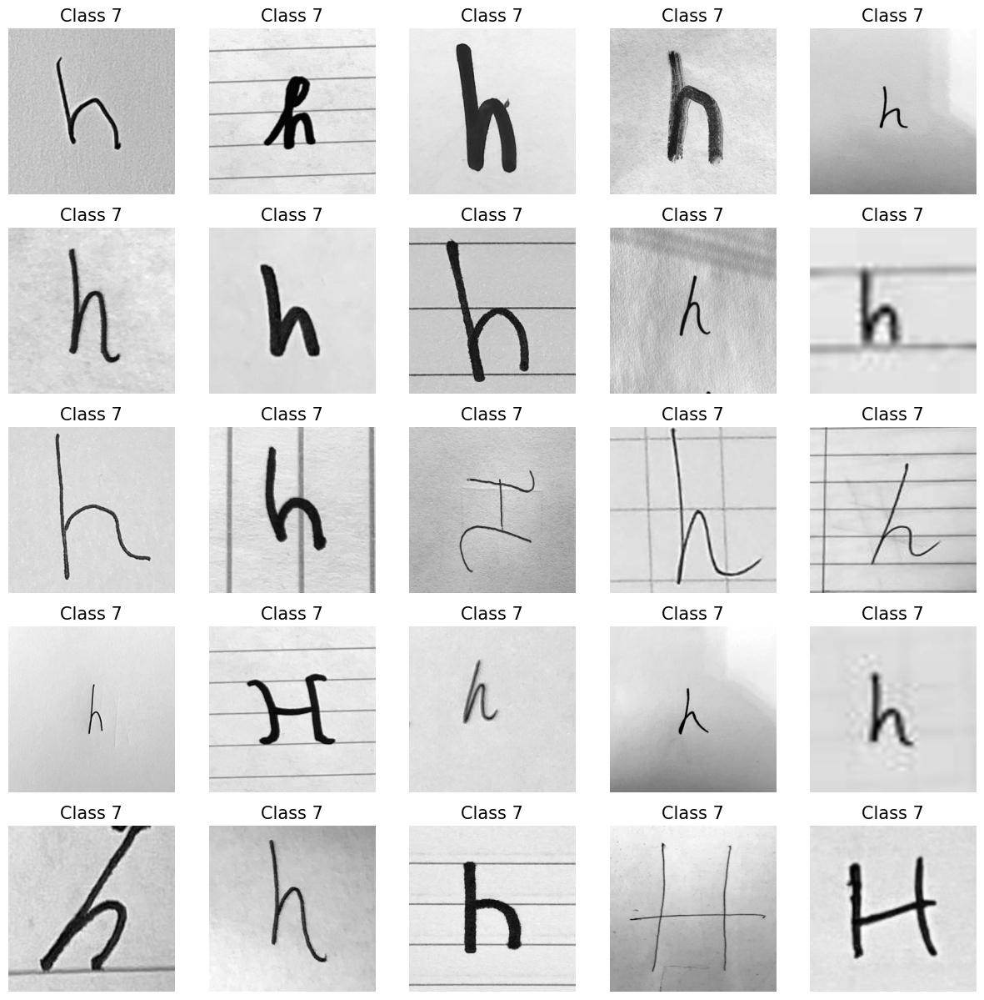

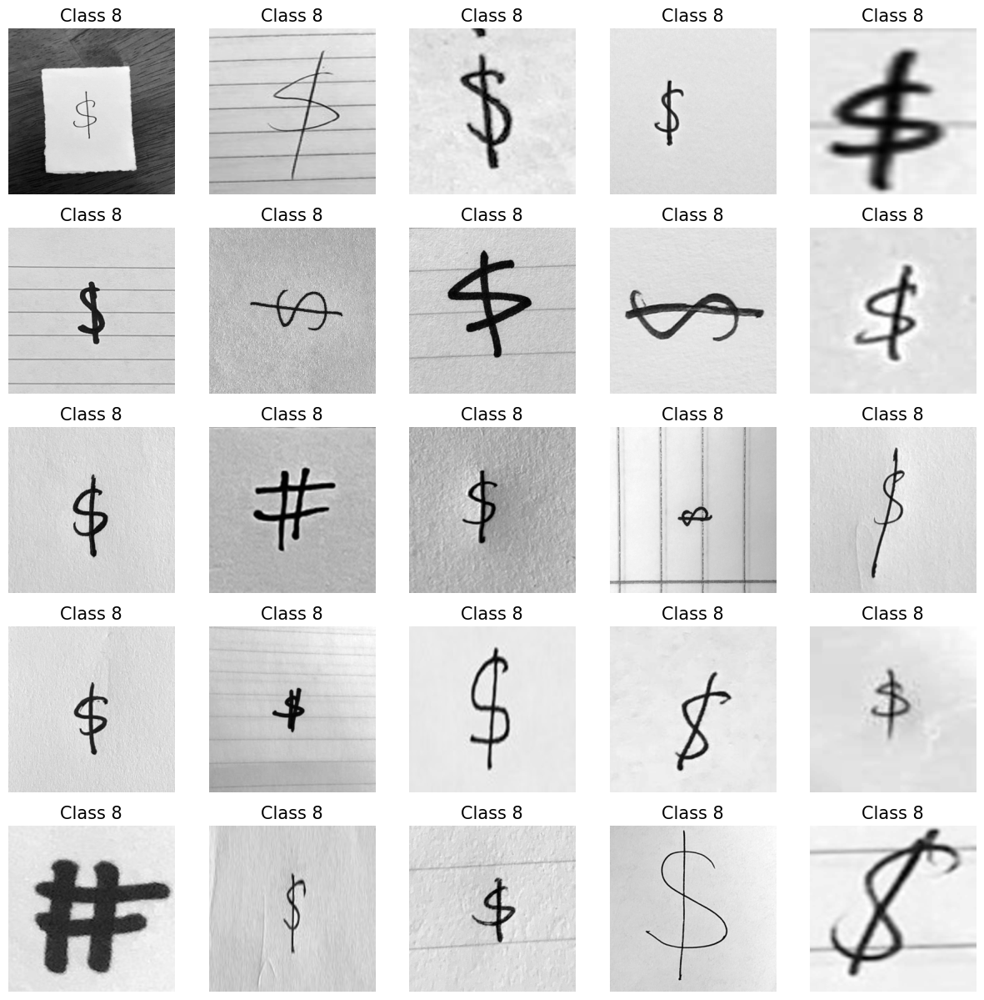

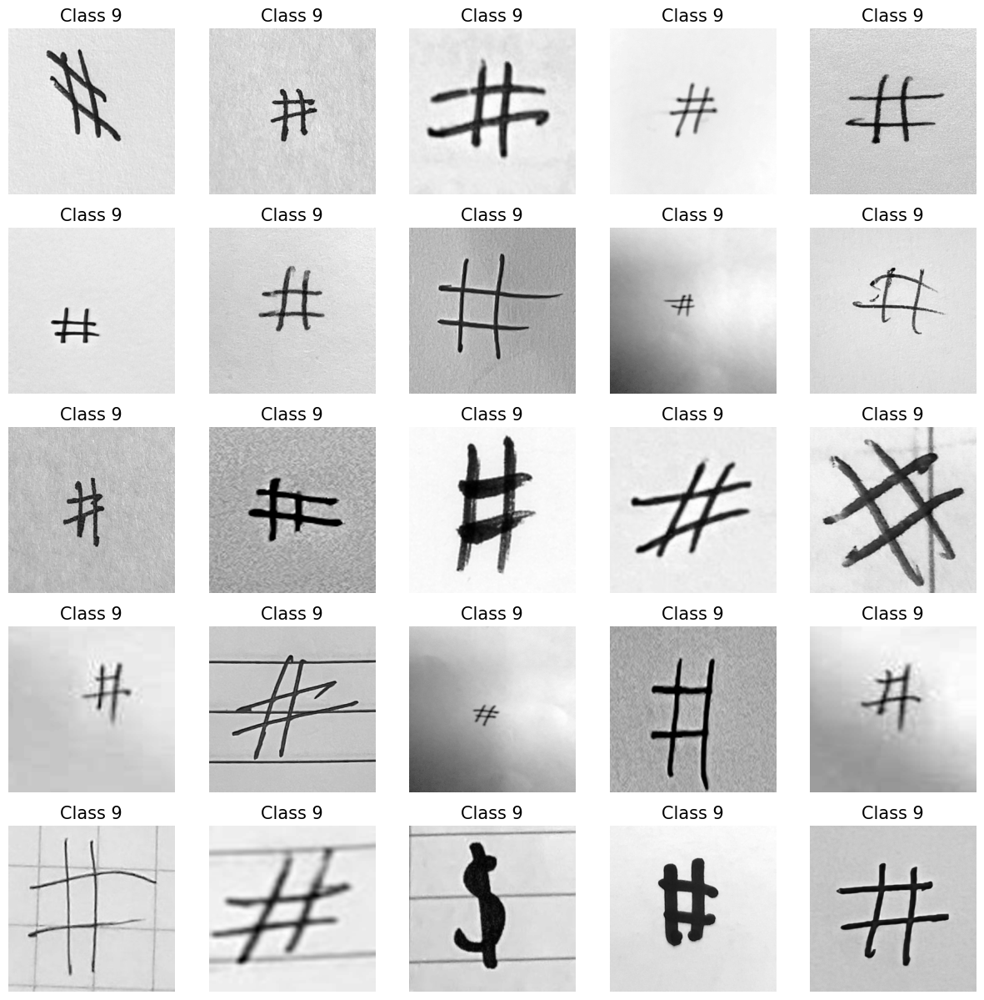

In [ ]:
# Displaying some random examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[rnd_sample[j],:].reshape((300,300)),cmap='gray')
        plt.axis('off');plt.title('Class '+str(int(t_train[rnd_sample[j]])),size=15)
    plt.show()
    print('\n\n')

---

# Data Preprocessing
Correcting the mislabeled instances

Since we can see a lot of mislabeled instances from the above random examples, it is better to correct these mislabeled instances. This has been achieved manually through the below code.

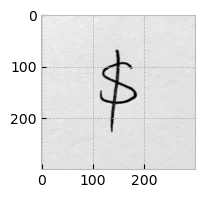

$ 	 0
Enter corrected label (if):


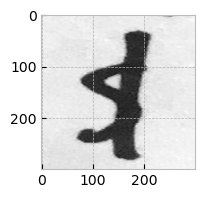

# 	 1
Enter corrected label (if):4


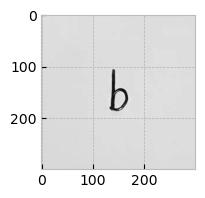

b 	 2
Enter corrected label (if):xx


In [ ]:
# Loading the original Data
X_train = np.load('data_train.npy').T
t_train = np.load('labels_train.npy')

dictout = {0:'a', 1:'b', 2:'c', 3:'d', 4:'e', 5:'f', 6:'g', 7:'h', 8:'$', 9:'#'}
dictin = {'a':0, 'b':1, 'c':2, 'd':3, 'e':4, 'f':5, 'g':6, 'h':7, '4':8, '3':9}

new_idx = 0
while new_idx < len(X_train):
    plt.figure(figsize=(2,2))
    plt.imshow(X_train[new_idx].reshape(300,300), cmap = 'gray')
    plt.show()

    print(dictout[t_train[new_idx]],'\t',new_idx)

    l = input('Enter corrected label (if):')

    if l == '':
        new_idx += 1  # Move to the next index
    elif l == 'x':
        new_idx = new_idx - 2  # Go back two indices
        continue
    elif l == 'xx':
        break  # Exit the while loop
    else:
        t_train[new_idx] = dictin[l] # Update with the correct label for the instance
        new_idx += 1  # Move to the next index

# Save the corrected labels
np.save('t_train', t_test)

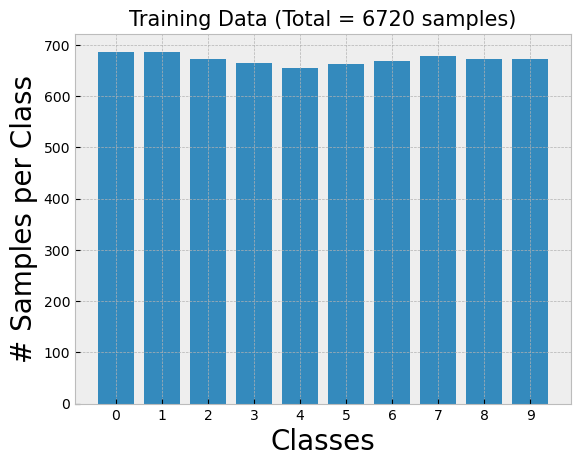

In [5]:
# Importing the new corrected labels
t_train = np.load('t_train.npy')

# Counting number samples per class with the corrected labels
vals, counts = np.unique(t_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train.shape[0])+' samples)',size=15);

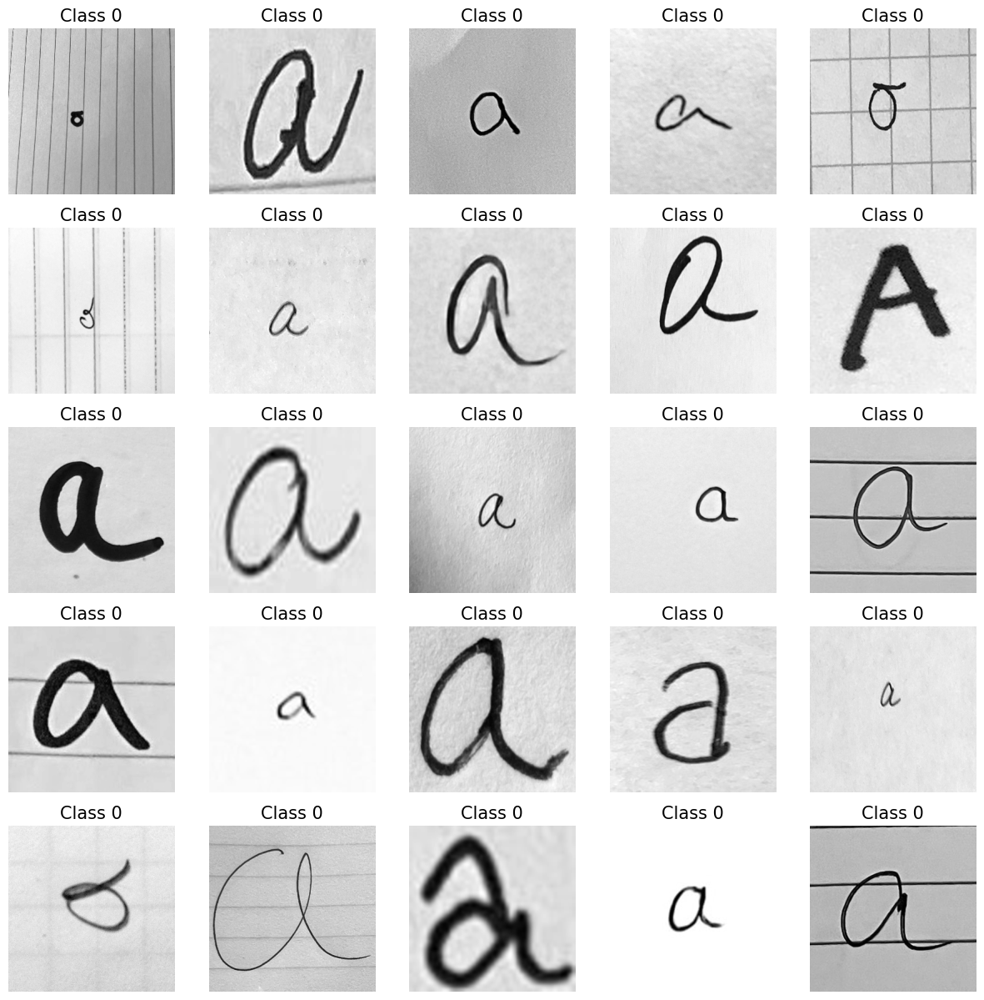

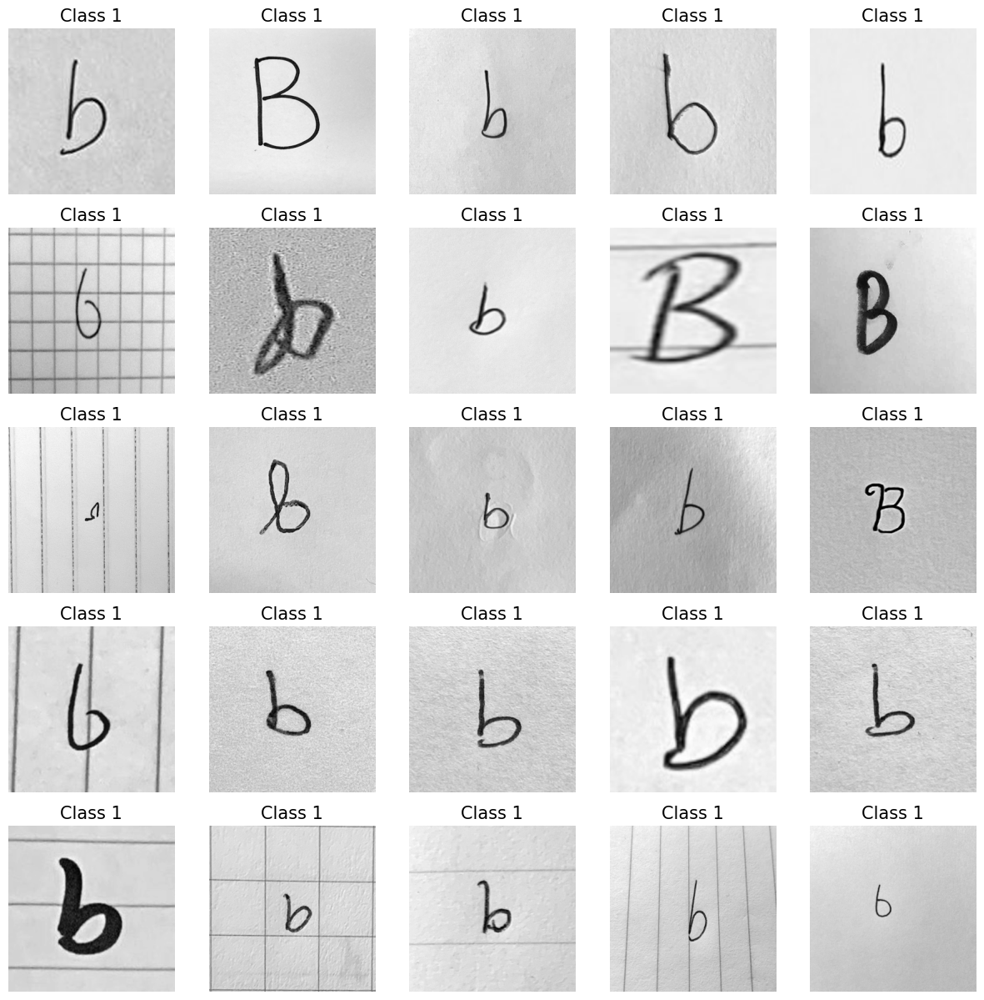

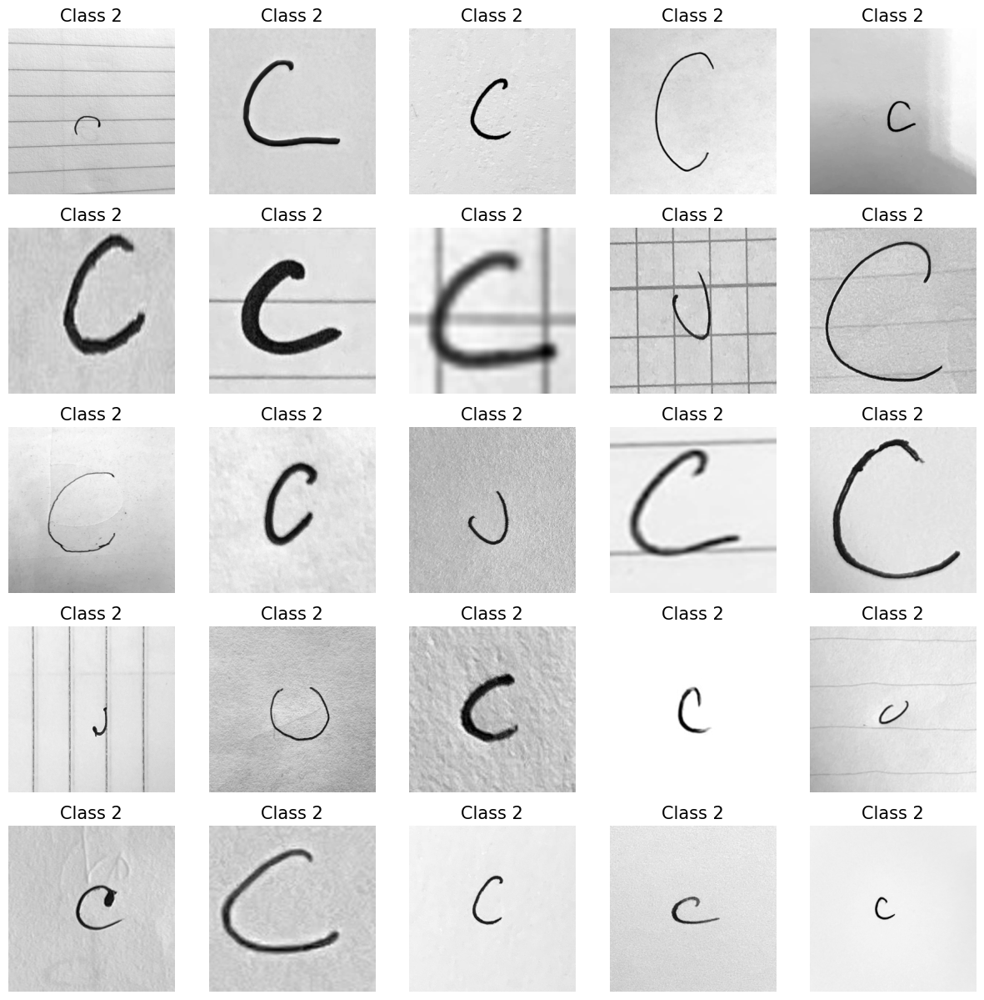

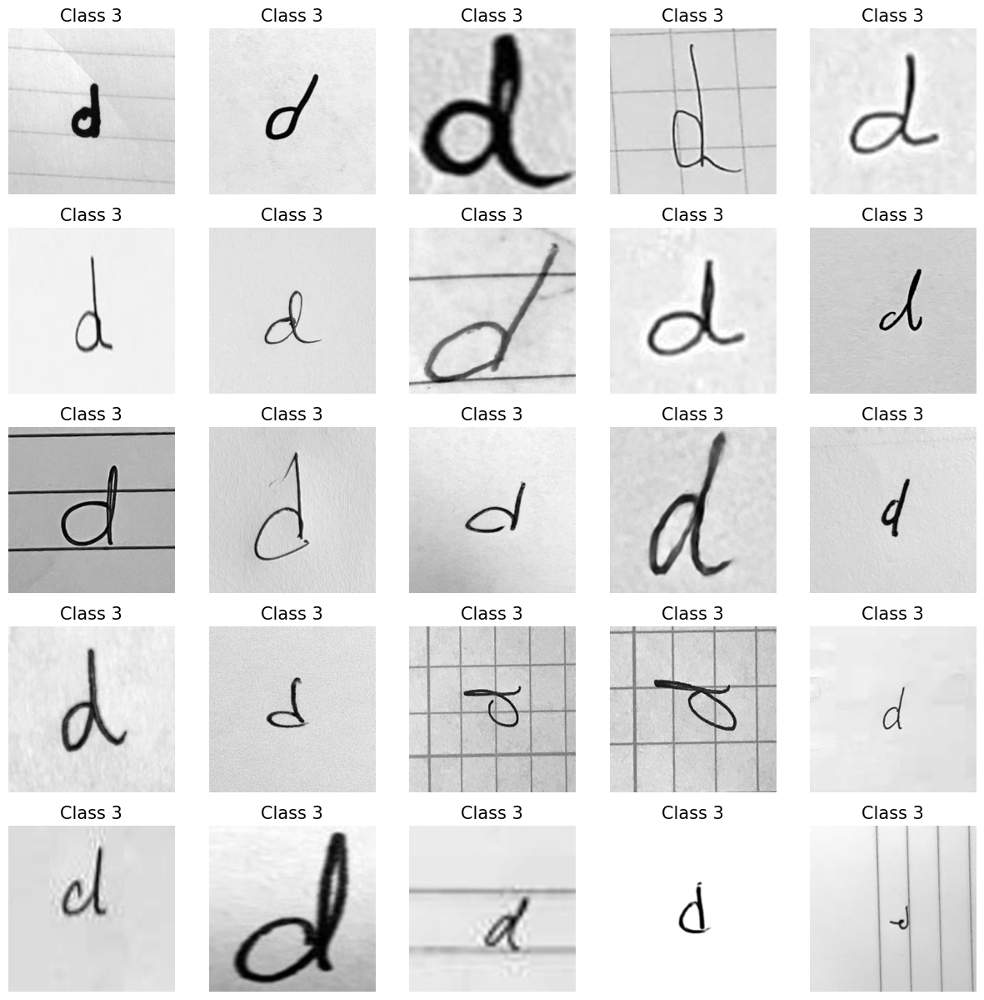

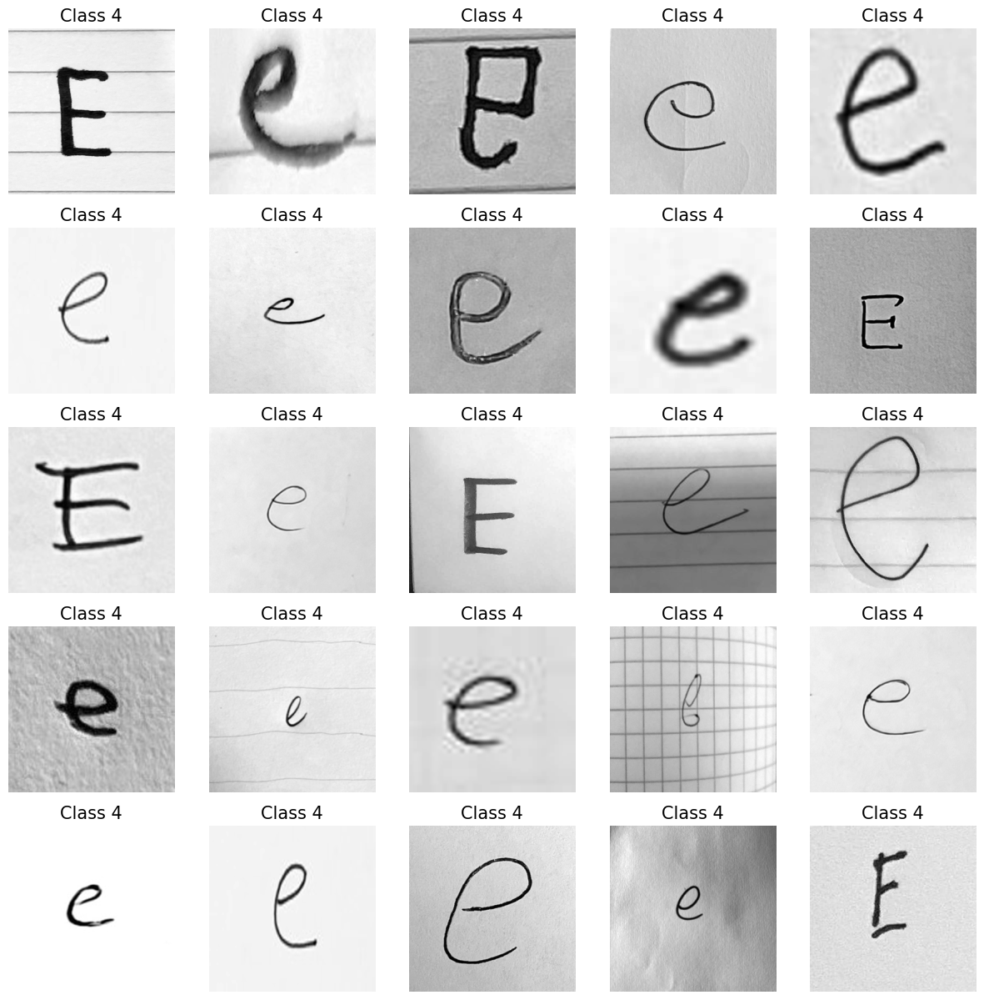

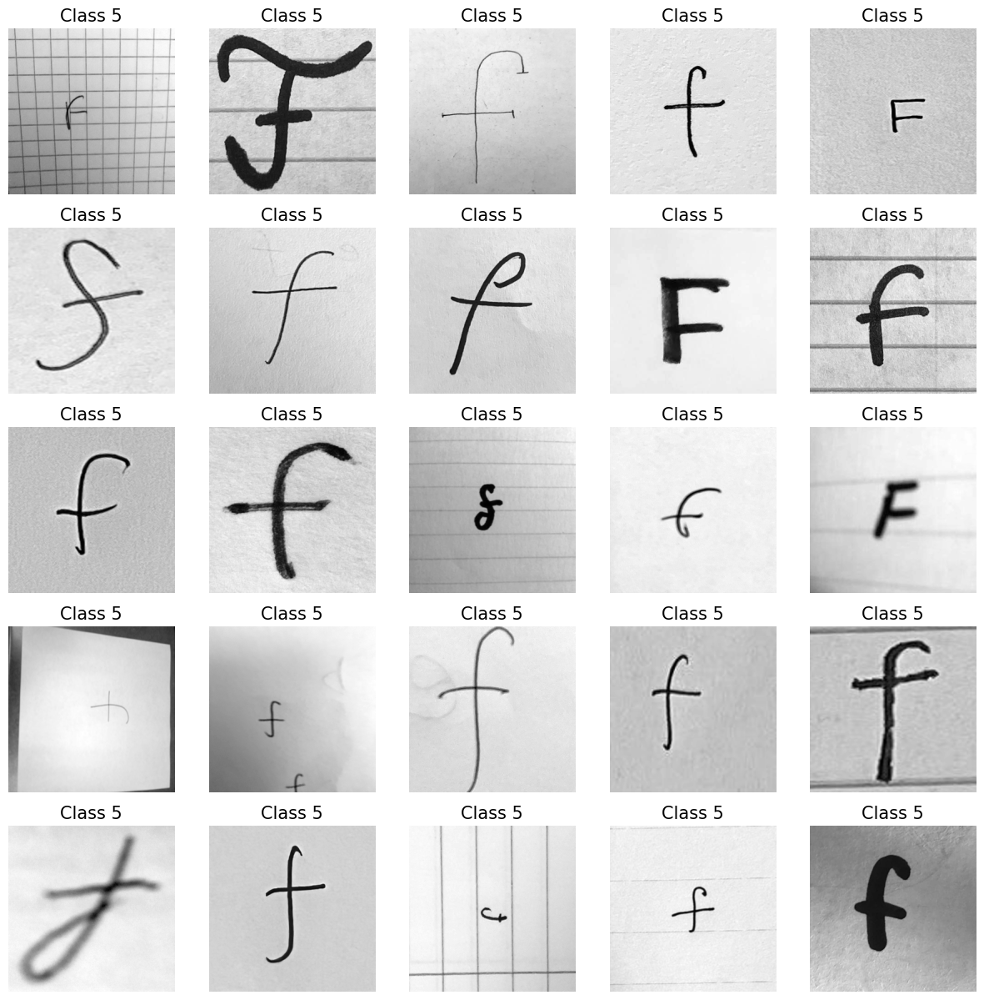

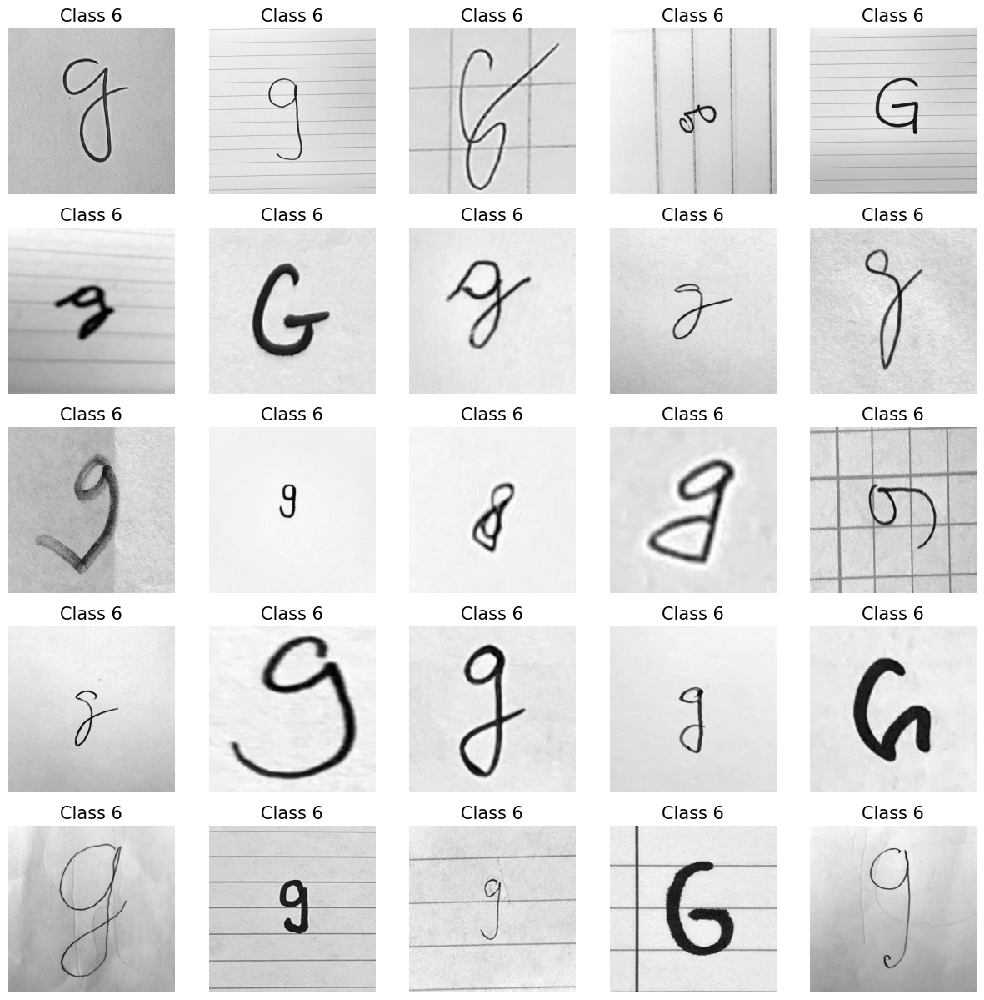

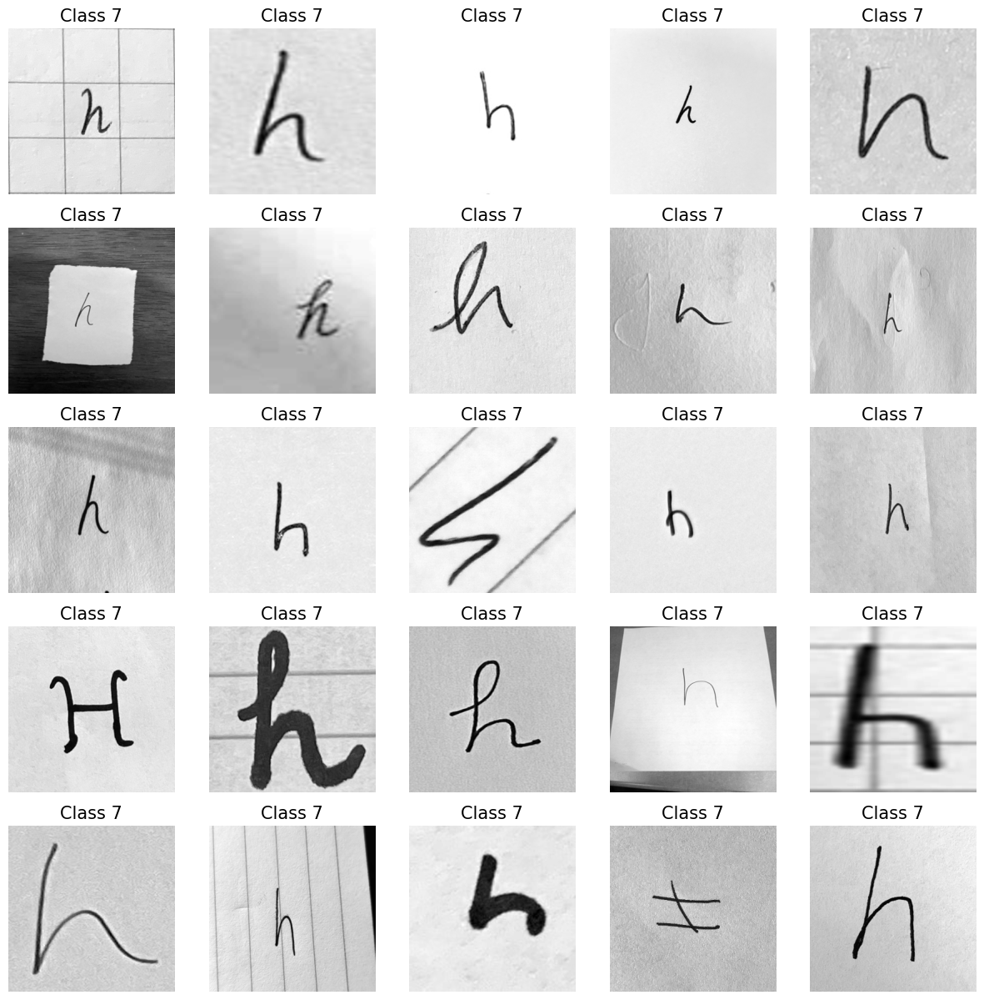

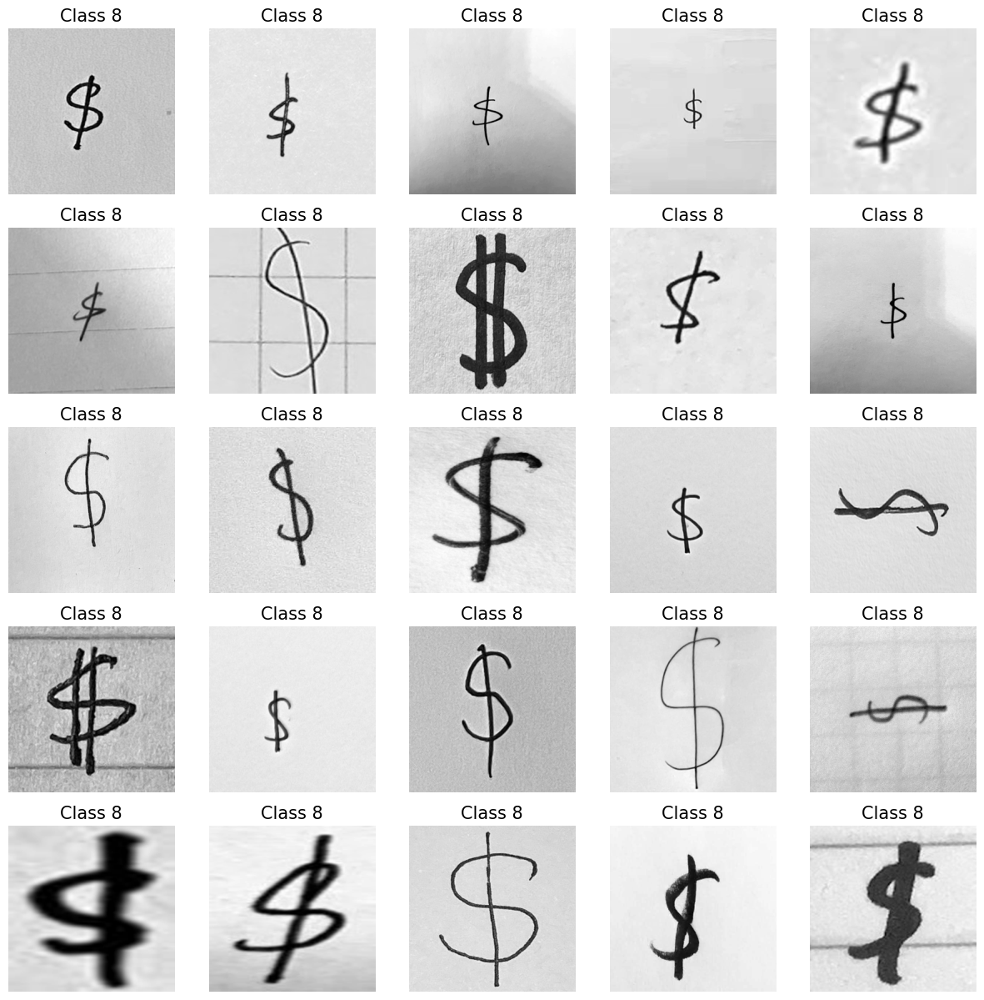

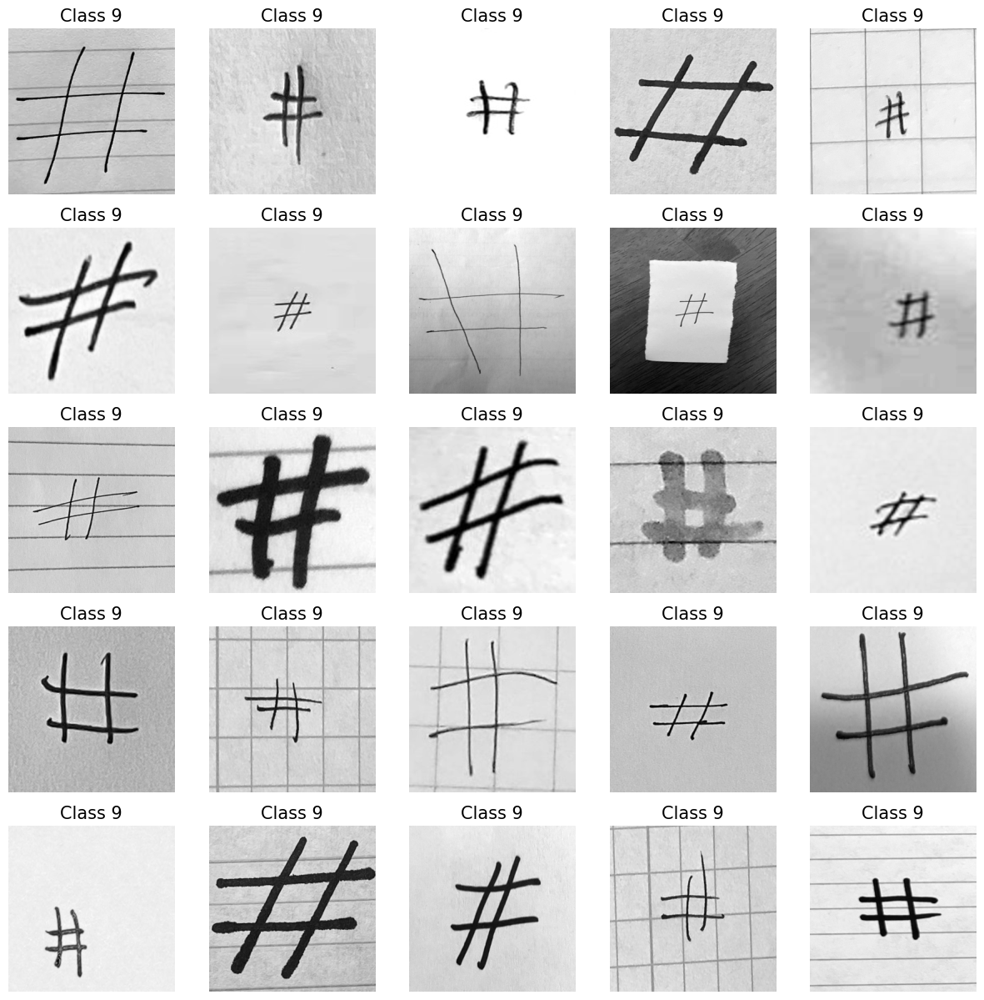

In [ ]:
import numpy.random as npr

# Displaying some random examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[rnd_sample[j],:].reshape((300,300)),cmap='gray')
        plt.axis('off');plt.title('Class '+str(int(t_train[rnd_sample[j]])),size=15)
    plt.show()
    print('\n\n')

# Assignment

## Reducing the Images' Pixel size
For better computation

In [2]:
import numpy as np

# Loading the Training Data with corrected labels
X_train = np.load('data_train.npy').T
t_train = np.load('t_train.npy')

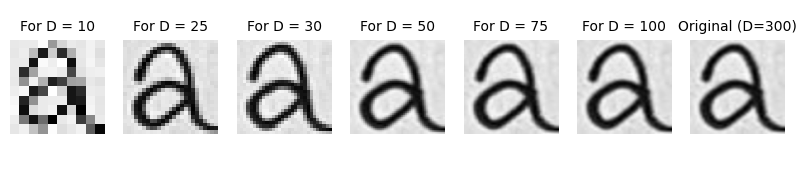

In [ ]:
# Choosing a D to reduce from 300 x 300 for limited computational resources
import matplotlib.pyplot as plt
import random
import cv2

D = [10,25,30,50,75,100] # Dimensions to reduce to DxD

samplei = random.randint(0,len(X_train))

fig=plt.figure(figsize=(10,2))
plt.axis('off')

for v,i in enumerate(D):
  X_train_reshaped = np.array(cv2.resize(X_train[samplei].reshape(300,300),(i,i)).reshape(i*i))

  fig.add_subplot(1,len(D)+1,v+1)
  plt.imshow(X_train_reshaped.reshape((i,i)),cmap='gray')
  plt.axis('off');plt.title(f'For D = {i}', size=10)

fig.add_subplot(1,len(D)+1,len(D)+1)
plt.imshow(X_train[samplei,:].reshape((300,300)),cmap='gray')
plt.axis('off');plt.title('Original (D=300)', size=10)

plt.show()

From the above image, D = 50 looks as good as D = 300. So, we can reduce the Pixel size from 300 $\times$ 300 to 50 $\times$ 50. Therefore, we will be reducing the feature space from 90000 dimensions to 2500 dimensions, hence making the computations faster and cheaper.

In [3]:
# Resizing the images from 300x300 pixels to 50x50 for faster computation
import cv2

D = 50
X_train_resized = np.array([cv2.resize(x.reshape(300,300),(D,D)).reshape(D*D) for x in X_train])

## 1. RFE
1. Implement Recursive Feature Elimination (RFE) to select the subset of features. Experiment with at least 2 different estimators.

    * Identify which pixels are selected and display mask examples from the training dataset.

Implementing Recursive Feature Elimination (RFE) with Logistic Regression

In [ ]:
import numpy as np
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Experimenting with the step size and n_features in RFE
steps = [0.05, 0.1, 0.2, 0.3]
n_features = [625, 900, None]

best_score = 0

# Looping through the step sizes to check for best performance
for step in steps:
    # Looping through the n_features to check for best performance
    for n in n_features:
        rfe_with_lr = RFE(LogisticRegression(), n_features_to_select=n, step=step)
        rfe_with_lr.fit(X_train_resized, t_train)

        score = rfe_with_lr.score(X_train_resized, t_train)

        if score > best_score:
            best_score = score
            best_rfe_with_lr = rfe_with_lr

            # Creating the mask of selected features
            selected_feature_mask = rfe_with_lr.support_.reshape(D,D)

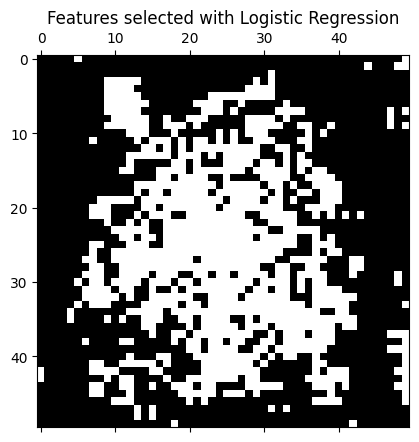

In [ ]:
# Plotting the mask
plt.matshow(selected_feature_mask, cmap='gray')
plt.title('Features selected with Logistic Regression')
plt.show()

In [ ]:
import joblib

# Saving the trained models as pickle files
joblib.dump(best_rfe_with_lr, 'RFE_with_LR.pkl');

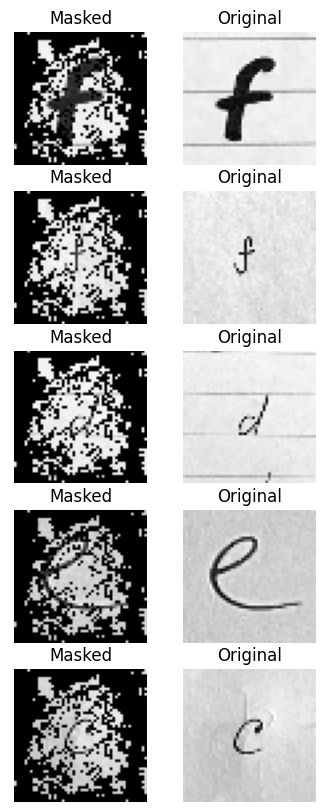

In [ ]:
# Masked examples from the training set
import random

fig=plt.figure(figsize=(4,10))
plt.axis('off')

for i in range(5):
  samplei = random.randint(0,len(X_train))
  X_train_masked = (X_train_resized[samplei]*best_rfe_with_lr.support_).reshape(D,D)

  fig.add_subplot(5,2,2*i+1)
  plt.imshow(X_train_masked, cmap='gray')
  plt.axis('off');plt.title('Masked')

  fig.add_subplot(5,2,2*i+2)
  plt.imshow(X_train_resized[samplei,:].reshape((D,D)),cmap='gray')
  plt.axis('off');plt.title('Original')

plt.show()

Implementing Recursive Feature Elimination (RFE) with Random Forest Classifier

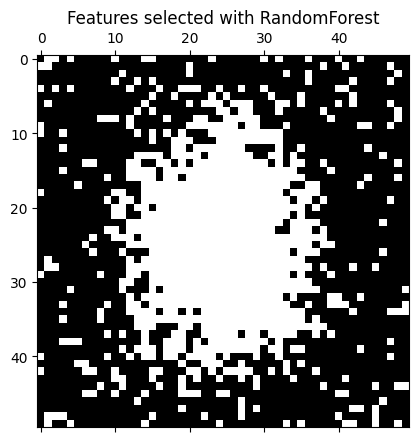

In [ ]:
import numpy as np
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt


# Defining the Random Forest estimator
estimator_rf = RandomForestClassifier(n_estimators=10, random_state=0)

# Experimenting with the step size and n_features in RFE
steps = [0.05, 0.1, 0.2, 0.3]
n_features = [625, 900, None]

best_score = 0

# Looping through the step sizes to check for best performance
for step in steps:
    # Looping through the n_features to check for best performance
    for n in n_features:
        rfe_with_rf = RFE(estimator_rf, n_features_to_select=n, step=step)
        rfe_with_rf.fit(X_train_resized, t_train)

        score = rfe_with_rf.score(X_train_resized, t_train)

        if score > best_score:
            best_score = score
            best_rfe = rfe_with_rf

            # Creating a mask of selected features
            selected_feature_mask = rfe_with_rf.support_.reshape(D,D)

# Plotting the mask
plt.matshow(selected_feature_mask, cmap='gray')
plt.title('Features selected with RandomForest')
plt.show()

In [ ]:
import joblib

# Saving the trained models as pickle files
joblib.dump(best_rfe, 'RFE_with_RF.pkl');

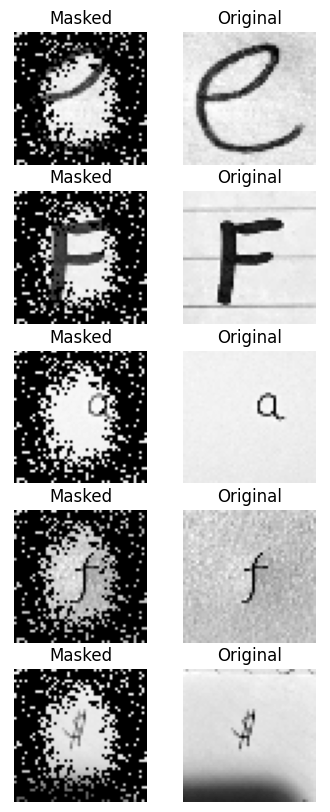

In [ ]:
# Masked examples from the training set
import random

fig=plt.figure(figsize=(4,10))
plt.axis('off')

for i in range(5):
  samplei = random.randint(0,len(X_train))
  X_train_masked = (X_train_resized[samplei]*best_rfe.support_).reshape(D,D)

  fig.add_subplot(5,2,2*i+1)
  plt.imshow(X_train_masked, cmap='gray')
  plt.axis('off');plt.title('Masked')

  fig.add_subplot(5,2,2*i+2)
  plt.imshow(X_train_resized[samplei,:].reshape((D,D)),cmap='gray')
  plt.axis('off');plt.title('Original')

plt.show()

## 2. PCA
2. Implement Principal Component Analysis (PCA) to select the number of components that explain at least 90% of the explained variance. Train a classifier on the original dataset and the reduced dataset.
    * Was training faster using the reduced dataset?
    * Compare performances.
    * Visualize the top 10 eigenvectors. Discuss what they represent.
    * Visualize examples of image reconstruction from PCA projections.

In [58]:
from sklearn.decomposition import PCA

# Creating PCA to select features that explain 90% of variance
pca = PCA(n_components=0.90)

# Transforming the training data with the PCA
X_pca = pca.fit_transform(X_train_resized)

# Checking for the number of components for 90% explained variance
print('Number of components for 90% of explained variance:', pca.n_components_)

Number of components for 90% of explained variance: 165


In [59]:
from sklearn.model_selection import train_test_split

# Splitting the Training data into Train and test sets to evaluate performance
X_train_tr, X_train_t, t_train_tr, t_train_t = train_test_split(X_train_resized,
                                                                t_train,
                                                                test_size=0.2,
                                                                random_state=43)
X_pca_train, X_pca_test = train_test_split(X_pca, test_size=0.2,
                                           random_state=43)

Training on the Original Dataset

In [60]:
from sklearn.ensemble import RandomForestClassifier
import time

# Choosing Random Forest Classifier to train on the original dataset
rf = RandomForestClassifier(n_estimators=300)
# Timing the training for the original dataset
start_time = time.time()
rf.fit(X_train_tr, t_train_tr)
training_time_original = time.time() - start_time

Training on the Reduced Dataset

In [61]:
# Choosing Random Forest Classifier to train on the reduced dataset
rf_pca = RandomForestClassifier(n_estimators=300)
# Timing the training for the reduced dataset
start_time = time.time()
rf_pca.fit(X_pca_train, t_train_tr)
training_time_pca = time.time() - start_time

Comparing the Performances

In [7]:
# Comparing the Training times for the two cases
print(f"Training time for the original dataset: {training_time_original:.4f}s")
print(f"Training time for the reduced dataset: {training_time_pca:.4f}s")

Training time for the original dataset: 79.2785s
Training time for the reduced dataset: 24.9845s


From the above training times, we can see that the time taken for training on the Reduced Dataset is much shorter than the time taken for training on the Original Dataset.

In [8]:
from sklearn.metrics import classification_report

# Comparing the performances
print("Accuracies for the Original Dataset:")
print('Training Set:', rf.score(X_train_tr, t_train_tr))
print('Test Set:', rf.score(X_train_t, t_train_t), '\n')

print("Accuracies for the Reduced Dataset:")
print('Training Set:', rf_pca.score(X_pca_train, t_train_tr))
print('Test Set:', rf_pca.score(X_pca_test, t_train_t), '\n')

# Comparing performances with Classification reports
y_pred_original = rf.predict(X_train_t)
print("Performance on the original dataset:")
print(classification_report(t_train_t, y_pred_original))
y_pred_reduced = rf_pca.predict(X_pca_test)
print("Performance on the reduced dataset:")
print(classification_report(t_train_t, y_pred_reduced))

Accuracies for the Original Dataset:
Training Set: 1.0
Test Set: 0.46056547619047616 

Accuracies for the Reduced Dataset:
Training Set: 1.0
Test Set: 0.5602678571428571 

Performance on the original dataset:
              precision    recall  f1-score   support

         0.0       0.42      0.51      0.46       130
         1.0       0.35      0.44      0.39       116
         2.0       0.43      0.69      0.53       144
         3.0       0.64      0.38      0.47       152
         4.0       0.56      0.44      0.49       142
         5.0       0.41      0.33      0.36       143
         6.0       0.38      0.46      0.42       106
         7.0       0.43      0.37      0.40       134
         8.0       0.44      0.47      0.46       126
         9.0       0.66      0.52      0.58       151

    accuracy                           0.46      1344
   macro avg       0.47      0.46      0.46      1344
weighted avg       0.48      0.46      0.46      1344

Performance on the reduced datas

From the above performance results, we can say that the performace improved from the original dataset to the reduced dataset at a lower computational cost. This is because PCA extracts more useful features and hence the perfrmance will be better and faster using less number of features but more important features.

In [62]:
import joblib

# Saving the Trained PCA
joblib.dump(pca, 'PCA.pkl')
joblib.dump(rf, 'RF_without_PCA.pkl')
joblib.dump(rf_pca, 'RF_with_PCA.pkl');

Visualizing the Top 10 Eigenvectors

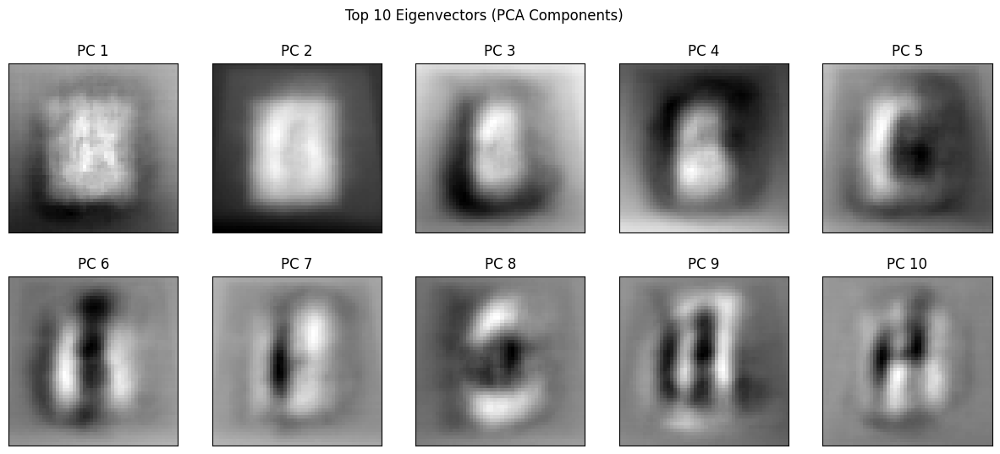

In [16]:
import matplotlib.pyplot as plt

# Displaying the Top 10 Eigen Vectors
fig, axes = plt.subplots(2, 5, figsize=(15, 6), subplot_kw={'xticks':[], 'yticks':[]})
fig.suptitle('Top 10 Eigenvectors (PCA Components)')

# Plotting the vectors
for i, ax in enumerate(axes.ravel()):
    ax.imshow(pca.components_[i].reshape(D,D), cmap='gray')
    ax.set_title(f"PC {i+1}")
plt.show()

From the above visualization, the top 10 eigenvestors represent the following:   
- PC1, PC2 - These eigenvectors have higher values in the center in the shape of a rectangle. This might mean that the first eigenvectors capture the data in the center of the image. This makes sense because, the images in the dataset contain the written symbols mostly in the center of the image.   
- PC3, PC4 - These eigenvectors also capture the center data but this center area, here, is smaller than the first two eigenvectors. This eigen vector might represent the smaller sized written symbols.   
- PC5 - This eigen vector captures the data at the border of the center area. So, this eigenvector represents the data that is not in the exact center but the periphery of the center.   
- PC6, PC7 - These two eigenvectors capture and represent the data in the left and right sides of the center area of the image.   
- PC8 - This eigenvector captures and represents the data in the top and bottom portions of the center of the image.   
- PC9, PC10 - These eigenvectors, apparently, form a complex shape but look for the data mostly in the center of the image.

Visualizing reconstructed images from PCA projections

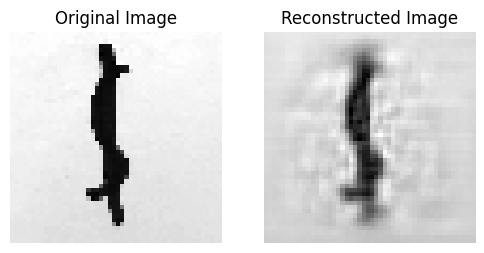

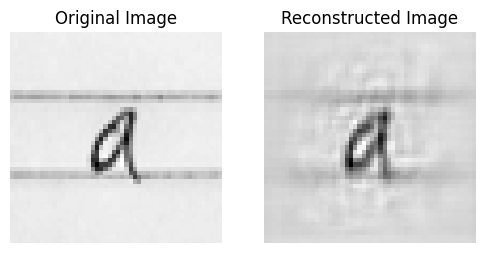

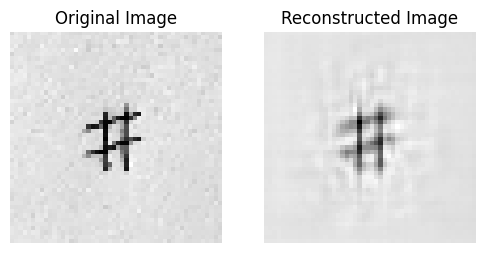

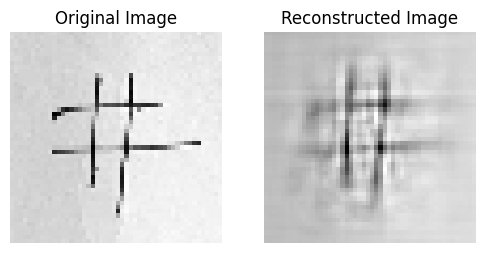

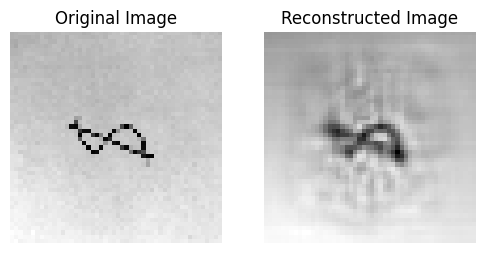

In [24]:
import random

# Reconstructing images from PCA projections
reconstructed_images = pca.inverse_transform(X_pca_train)

# Visualizing five examples from the training set
for i in range(5):
    idx=random.randint(0,len(X_train_tr))

    # Displaying original and reconstructed images side-by-side
    fig, axes = plt.subplots(1, 2, figsize=(6, 3))
    axes[0].imshow(X_train_tr[idx].reshape(D,D), cmap='gray')
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    axes[1].imshow(reconstructed_images[idx].reshape(D,D), cmap='gray')
    axes[1].set_title("Reconstructed Image")
    axes[1].axis('off')
    plt.show()

From the above reconstructions, we can notice that eventhough the reconstructions are not as good as the original image, they retain the important information to classify the images.

---

## 3. LDA and t-SNE
#### Question 3 is required for completion for the EEL 5934 section only. Individuals in EEL 4930 are welcome to solve these tasks but no extra credit will be credited.

3. Use Fisher's Linear Discriminant Analysis (LDA) and t-SNE to reduce the dataset to 2-dimensions and visualize it.
    * Visualize the dataset, be sure to color-code each point to its corresponding target label.
    * How many features would you select? Why?
    * Visualize and compare the 2-dimensional projections with PCA. Discuss your observations.

Using Fisher's Linear Discriminant Analysis (LDA)

In [6]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

# Using Fisher's LDA to reduce to 2 dimensions
lda_2D = LDA(n_components=2)
X_lda = lda_2D.fit_transform(X_train_resized, t_train)

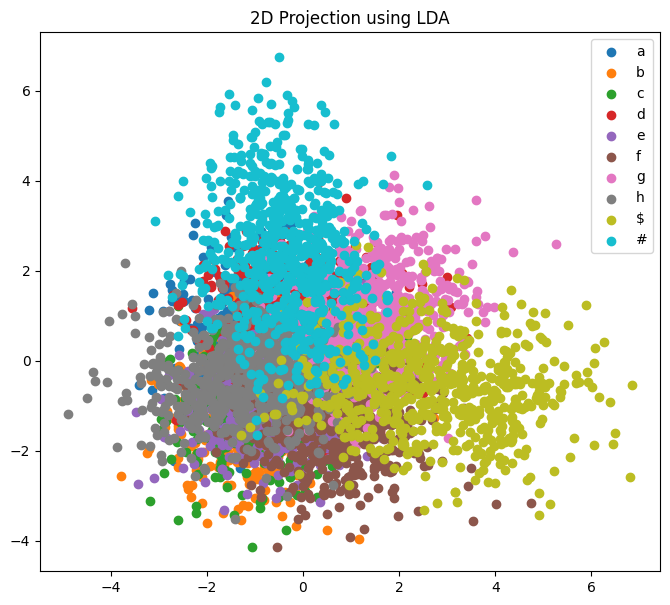

In [7]:
import matplotlib.pyplot as plt

# Visualizing the 2D projection with LDA
plt.figure(figsize=(8, 7))
for i in np.unique(t_train):
    plt.scatter(X_lda[t_train == i, 0], X_lda[t_train == i, 1], label=class_names[int(i)])
plt.title('2D Projection using LDA')
plt.legend()
plt.show()

In [8]:
import joblib

# Saving the Trained LDA model
joblib.dump(lda_2D, 'LDA_for_2D.pkl');

['LDA_for_2D.pkl']

Using t-SNE

In [9]:
from sklearn.manifold import TSNE

# Using t-SNE to reduce to 2 dimensions
tsne = TSNE(n_components=2, learning_rate='auto', init='random')
X_tsne = tsne.fit_transform(X_train_resized)

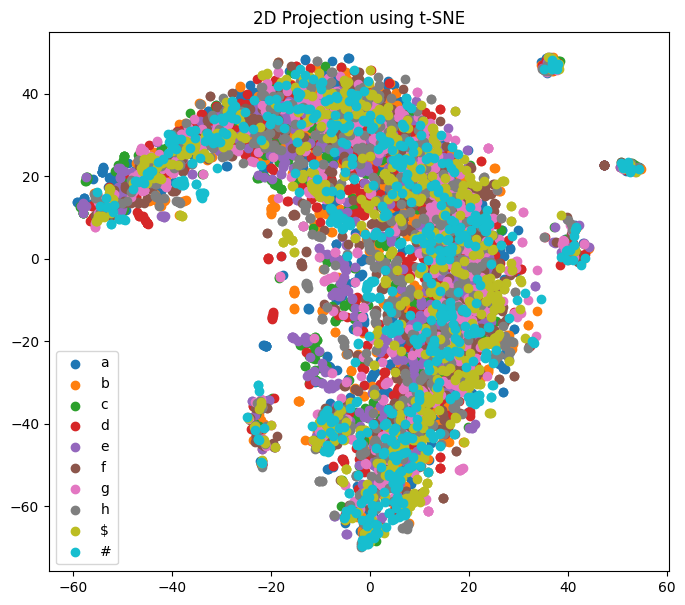

In [10]:
# Visualizing the 2D projection with t-SNE
plt.figure(figsize=(8, 7))
for i in np.unique(t_train):
    plt.scatter(X_tsne[t_train == i, 0], X_tsne[t_train == i, 1], label=class_names[int(i)])
plt.title('2D Projection using t-SNE')
plt.legend()
plt.show()

In [11]:
import joblib

# Saving the Trained t-SNE model
joblib.dump(tsne, 't-SNE_for_2D.pkl');

From the above visualizations, it is apparent that LDA has better reduction to 2 dimensions than t-SNE in this case. In the LDA projection, we can clearly see the groups of classes seperated or populated close to their respective class instances. Whereas, in the visualization by t_SNE, all the classes seem to take the same shape/distribution making it harder to differentiate between classes. This is because LDA is a supervised algorithm and has the advantage of knowing the class labels to make the class seperation better.

Using LDA, it might be just feasible to select just 2 features but the performance is going to be much worse since there are classes that still overlap. But t-SNE performs much worse to select at 2 dimensions. So, for classification applications, reducing a 300 $\times$ 300 dimensions to 2 dimensions is not a good idea. The exact number of dimensions to select can be found out from further experimentation using a classifer. We cannot use visualization to select the number of features to select because we cannot plot more than 3 dimensions.

Hence, using LDA, the number of features to select might be based on the number of distinct classes minus one. In LDA, the number of discriminant axes is at most c - 1, where c is the number of classes.

In t-SNE, opting for a much higher dimensional spcae is preferred because as we saw from the visualizations, the class seperation is not good enough to achieve reasonable performance.

Using PCA

In [12]:
from sklearn.decomposition import PCA

# Using PCA to reduce to 2 dimensions
pca_2D = PCA(n_components=2)
X_pca_2D = pca_2D.fit_transform(X_train_resized)

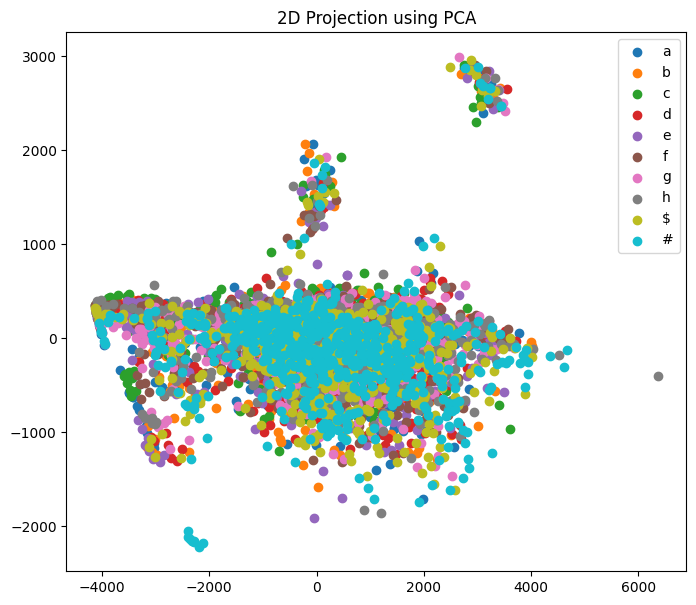

In [13]:
# Visualizing the 2D projection with PCA
plt.figure(figsize=(8, 7))
for i in np.unique(t_train):
    plt.scatter(X_pca_2D[t_train == i, 0], X_pca_2D[t_train == i, 1], label=class_names[int(i)])
plt.title('2D Projection using PCA')
plt.legend()
plt.show()

In [14]:
import joblib

# Saving the Trained t-SNE model
joblib.dump(pca_2D, 'PCA_for_2D.pkl');

From the above visualization of 2-dimensions using PCA, the obtained plot is similar to that of t-SNE. Here, the class seperation is not as good as LDA (again, this is because PCA is also unsupervised but LDA is not) but the instances of all classes seem to follow the same distribution.

**One major observation that is apparent from the visualizations of t_SNE and PCA is that these visualizations aid very well in identifying the outliers in each class.** As we can see, there are a few (mainly two) blobs of instances located off of the main distribution, which could indicate that these instances are outliers in the dataset.

---

## 4. Manifolds
4. Implement at least 3 manifold learning algorithms for reducing the dimensionality of the feature space. Utilize the new lower-dimensional feature space to build a classifier.

    * Which manifold learning algorithm would you select?
    
    * Visualize and interpret what the first 2 dimensions in the manifold learning algorithm you train.

#### MDS

In [42]:
from sklearn.manifold import MDS

mds1 = MDS(n_components=100)
X_mds1 = mds1.fit_transform(X_train_resized)

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_mds.py:299: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


In [43]:
from sklearn.model_selection import train_test_split

# Splitting the Training data into Train and test sets to evaluate performance
X_mds_train, X_mds_test, t_train_tr, t_train_t = train_test_split(X_mds1, t_train,
                                                                  test_size=0.2,
                                                                  random_state=43)

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Random forest Classifier for the MDS reduced dataset
mds_rf = RandomForestClassifier(random_state=0)
mds_rf.fit(X_mds_train, t_train_tr)

# Evaluating the classifier
t_pred_mds = mds_rf.predict(X_mds_test)
print(classification_report(t_train_t, t_pred_mds))

              precision    recall  f1-score   support

         0.0       0.08      0.12      0.10       130
         1.0       0.08      0.10      0.09       116
         2.0       0.19      0.25      0.21       144
         3.0       0.18      0.11      0.13       152
         4.0       0.14      0.10      0.12       142
         5.0       0.12      0.10      0.11       143
         6.0       0.13      0.15      0.14       106
         7.0       0.13      0.09      0.10       134
         8.0       0.16      0.18      0.17       126
         9.0       0.24      0.21      0.22       151

    accuracy                           0.14      1344
   macro avg       0.14      0.14      0.14      1344
weighted avg       0.15      0.14      0.14      1344



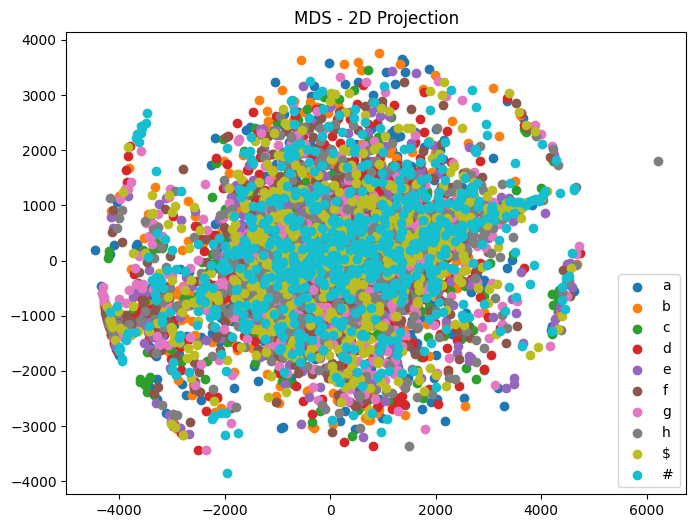

In [10]:
# Visualizing the 2D projection using MDS
from sklearn.manifold import MDS

mds = MDS(n_components=2)
X_mds = mds.fit_transform(X_train_resized)

import matplotlib.pyplot as plt

# Visualizing the 2D projection
plt.figure(figsize=(8, 6))
for label in np.unique(t_train):
    plt.scatter(X_mds[t_train == label, 0], X_mds[t_train == label, 1], label=class_names[int(label)])
plt.title("MDS - 2D Projection")
plt.legend()
plt.show()

In [47]:
import joblib

# Saving the trained MDS models
joblib.dump(mds1, 'MDS.pkl')
joblib.dump(mds_rf, 'RF_with_MDS.pkl')
joblib.dump(mds, 'MDS_2D.pkl');

Since the accuracy obtained from reducing the features to 100 using MDS is not impressive, MDS might not be a good choice for this classification. Furthermore, 2D visualization using MDS tells us that there is no class seperation to be found and all the classes occupy the same distribution at the same locations. The training with MDS also takes significantly anf unreasonably longer than the other Manifold Learning Algorithms. Hence, MDS is not a good choice.

#### ISOMAP

In [49]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.manifold import Isomap

# Using ISOMAP to reduce to 100 features
isomap = Isomap(n_components=100, n_neighbors=50)
X_isomap = isomap.fit_transform(X_train_resized)

# Splitting the transformed data to apply a classifier
X_isomap_train, X_isomap_test, t_train_tr, t_train_t = train_test_split(X_isomap,
                                                                        t_train,
                                                                        test_size=0.2,
                                                                        random_state=42)

# Random Forest Classifier for the ISOMAP reduced dataset
isomap_rf = RandomForestClassifier(random_state=42)
isomap_rf.fit(X_isomap_train, t_train_tr)

# Evaluating the classifier
print('For the Training Set:')
y_pred_isomap = isomap_rf.predict(X_isomap_train)
print(classification_report(t_train_tr, y_pred_isomap))

print('\nFor the Test Set:')
t_pred_isomap = isomap_rf.predict(X_isomap_test)
print(classification_report(t_train_t, t_pred_isomap))

For the Training Set:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       540
         1.0       1.00      1.00      1.00       558
         2.0       1.00      1.00      1.00       556
         3.0       1.00      1.00      1.00       535
         4.0       1.00      1.00      1.00       532
         5.0       1.00      1.00      1.00       518
         6.0       1.00      1.00      1.00       535
         7.0       1.00      1.00      1.00       548
         8.0       1.00      1.00      1.00       524
         9.0       1.00      1.00      1.00       530

    accuracy                           1.00      5376
   macro avg       1.00      1.00      1.00      5376
weighted avg       1.00      1.00      1.00      5376


For the Test Set:
              precision    recall  f1-score   support

         0.0       0.33      0.32      0.33       146
         1.0       0.26      0.26      0.26       129
         2.0       0.37      0.50    

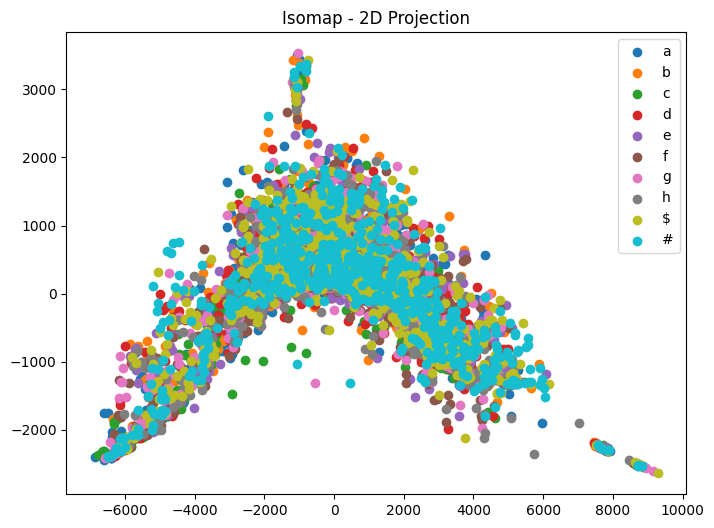

In [50]:
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap

isomap_2D = Isomap(n_components=2, n_neighbors=50)
X_isomap = isomap_2D.fit_transform(X_train_resized)

# Visualizing the 2D projection using ISOMAP
plt.figure(figsize=(8, 6))
for label in np.unique(t_train):
    plt.scatter(X_isomap[t_train == label, 0], X_isomap[t_train == label, 1], label=class_names[int(label)])
plt.title("Isomap - 2D Projection")
plt.legend()
plt.show()

In [51]:
import joblib

# Saving the Trained ISOMAP models
joblib.dump(isomap, 'ISOMAP.pkl')
joblib.dump(isomap_rf, 'RF_with_ISOMAP.pkl')
joblib.dump(isomap_2D, 'ISOMAP_2D.pkl');

#### LLE

In [54]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.manifold import LocallyLinearEmbedding

# Implementing LLE to reduce to 100 features
lle = LocallyLinearEmbedding(n_components=100, n_neighbors=50)
X_lle = lle.fit_transform(X_train_resized)

# Splitting the transformed data to apply a classifier
X_lle_train, X_lle_test, t_train_tr, t_train_t = train_test_split(X_lle, t_train,
                                                                  test_size=0.2,
                                                                  random_state=43)

# Random Forest Classifier for the LLE reduced dataset
lle_rf = RandomForestClassifier(random_state=43)
lle_rf.fit(X_lle_train, t_train_tr)

# Evaluating the classifier
print('For the Training Set:')
y_pred_lle = lle_rf.predict(X_lle_train)
print(classification_report(t_train_tr, y_pred_lle))

print('\nFor the Test Set:')
t_pred_lle = lle_rf.predict(X_lle_test)
print(classification_report(t_train_t, t_pred_lle))

For the Training Set:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       556
         1.0       1.00      1.00      1.00       571
         2.0       1.00      1.00      1.00       529
         3.0       1.00      1.00      1.00       513
         4.0       1.00      1.00      1.00       512
         5.0       1.00      1.00      1.00       520
         6.0       1.00      1.00      1.00       562
         7.0       1.00      1.00      1.00       545
         8.0       1.00      1.00      1.00       546
         9.0       1.00      1.00      1.00       522

    accuracy                           1.00      5376
   macro avg       1.00      1.00      1.00      5376
weighted avg       1.00      1.00      1.00      5376


For the Test Set:
              precision    recall  f1-score   support

         0.0       0.36      0.42      0.39       130
         1.0       0.29      0.38      0.33       116
         2.0       0.40      0.54    

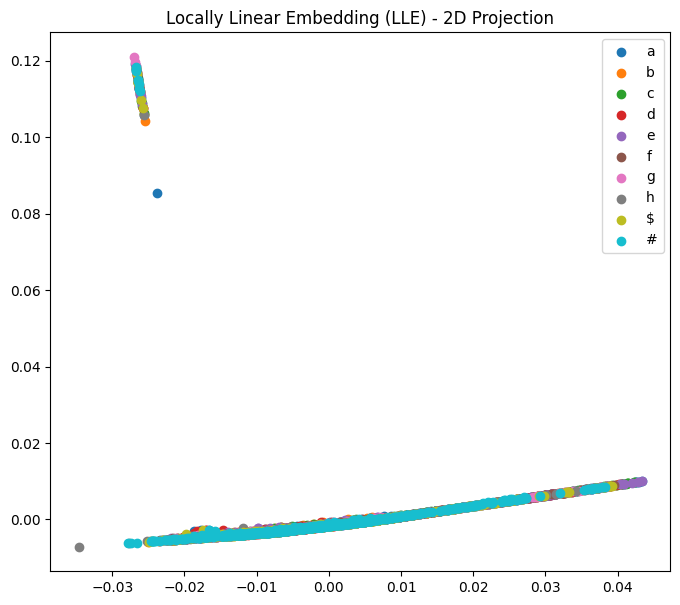

In [55]:
from sklearn.manifold import LocallyLinearEmbedding

lle_2D = LocallyLinearEmbedding(n_components=2, n_neighbors=50)
X_lle = lle_2D.fit_transform(X_train_resized)

# Visualizing the 2D projection using LLE
plt.figure(figsize=(8, 7))
for label in np.unique(t_train):
    plt.scatter(X_lle[t_train == label, 0], X_lle[t_train == label, 1], label=class_names[int(label)])
plt.title("Locally Linear Embedding (LLE) - 2D Projection")
plt.legend()
plt.show()

In [56]:
import joblib

# Saving the Trained LLE models
joblib.dump(lle, 'LLE.pkl')
joblib.dump(lle_rf, 'RF_with_LLE.pkl')
joblib.dump(lle_2D, 'LLE_2D.pkl');

Since, for the same number of features, LLE has a relatively higher accuracy than ISOMAP in the test case, LLE is preferable and selected.

### Test Function

For the test notebook, you will report performance in the test set which contains 2880 images of size $300\times 300$, also saved as a ```numpy``` array of size $90000\times 2880$.

In [6]:
# Loading Test Data
X_test = np.load('data_test.npy').T
t_test = np.load('labels_test.npy')

print(X_test.shape, t_test.shape)

(2880, 90000) (2880,)


Your Notebook should include:

1. Loading trained models from problems 1-4, and apply transformations to the test set.

2. For problems 2 and 4, report on the standard performance measures of classification. Discuss and present your results within the report.

---

# Submit Your Solution

Confirm that you've successfully completed the assignment.

Along with the Notebook, include a PDF of the notebook with your solutions.

```add``` and ```commit``` the final version of your work, and ```push``` your code to your GitHub repository.

Submit the URL of your GitHub Repository as your assignment submission on Canvas.

---